# Analysis of Market Returns of Large Banks
Author: **Peeyush Sharma**; Feedback: **PSharma3@gmail.com**

This analysis compares returns of largest US banks by assets: JP Morgan, Bank of America, Citigroup, Wells Fargo, Goldman Sachs, and Morgan Stanley. The analysis is primarily focused around the COVID-19 time-frame. These bank stocks are atypical value stocks which underperformed compared to broader market and especially against NASDAQ-100 / Tech sector primarily FAANG+M stocks. It is no secret that higher liquidity levels required with Dodd-Frank regulations helped banks tackle the COVID-19 impact, however, the need to set aside billions in Credit Losses caused the returns of these banks to suffer. We check the Q1/Q2 2020 returns for these large banks and touch on factors that caused differences in relative performance of these large banks. 

To skip bulk of the code and get directly to analysis go to # Use-cases and Scenarios section.

In [1]:
#Load packages
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import os.path
import plotly.express as px

from sklearn import preprocessing
from sqlalchemy import create_engine
from sqlalchemy import text
from datetime import datetime, timedelta

# from os import path
from functools import reduce
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()
#sns.set_theme(style="whitegrid")
sns.set(style="darkgrid")

In [2]:
BASE_DIR = '../../../../workspace/HelloPython/HistoricalMarketData/TechnicalIndicators'

In [3]:
try:
    DB = os.environ["DB"]
    DB_USER = os.environ["DB_USER"]
    DB_PWD = os.environ["DB_PWD"]
except KeyError:
    raise Exception("Required environment variables DB_USER and DB_PWD not set")
DB_URL = 'mysql+mysqlconnector://' + DB_USER + ':' + DB_PWD + '@localhost/' + DB
ENGINE = create_engine(DB_URL)

### Retrieval of daily closing++ (open, high, low, volume) values

#### Retrieval of OHLCV data for a list of stocks

In [54]:
def retrieve_ohlcv_data(symbols, str_date_from=None, str_date_to=None):
    """
    Returns OHLCV data from SQL DB as a dataframe for a
    list of symbols for given date range (optional)
    :param symbols:
    :param str_date_from:
    :param str_date_to:
    :return:
    """
    baseline_date = datetime(2000, 1, 1)
    yesterday = datetime.today() - timedelta(days=1)
    dt_from = None
    dt_to = None

    if str_date_from is None: dt_from = baseline_date.date()
    else: dt_from = datetime.strptime(str_date_from, '%Y-%m-%d').date()
    if str_date_to is None: dt_to = yesterday.date()
    else: dt_to = datetime.strptime(str_date_to, '%Y-%m-%d').date()

    # Convert symbol list into a string that we can pass in a SQL statement
    str_symbol_list = ','.join((f"'{symbol}'" for symbol in symbols))
    #print(str_symbol_list)

    q = ("select date, symbol, open, high, low, close, volume from equities_historic_data where "
         "date >")+datetime.strftime(baseline_date, '%Y-%m-%d')+"  and symbol in ("+str_symbol_list+")"

    with ENGINE.connect() as conn:
        res = conn.execute(text(q))
    df_data = pd.DataFrame(res.mappings().all())
    df_data.set_index(pd.to_datetime(df_data['date']), inplace=True)
    df_data.sort_index(ascending=True, inplace=True)
    df_data.drop('date', axis=1, inplace=True)
    df_data = df_data.loc[dt_from:dt_to, :] # None dates will yield full dfrm
    return df_data

In [55]:
# symbols = ["FSLR", "VRT", "COIN", "MRVL", "CRWD", "AVGO", "DDOG", "SMCI", "GOOGL", "AMZN", "SHAK", "APO", "DJT", "FCX"]
symbols = ["BAC", "GS", "JPM", "C", "WFC", "MS"]
tmp_dfrm = retrieve_ohlcv_data(symbols, '2025-04-21', '2026-04-25')
# tmp_dfrm = retrieve_ohlcv_data(symbols)
tmp_dfrm.tail(10)

,close,high,low,open,symbol,volume
date,,,,,,
2025-05-12,591.34,603.370,588.080,596.255,GS,3527740
2025-05-12,74.88,75.250,74.070,74.990,WFC,20425541
2025-05-12,127.06,129.200,126.440,127.420,MS,9162496
2025-05-12,43.36,43.955,42.940,43.320,BAC,44875064
2025-05-13,44.28,44.485,43.420,43.420,BAC,43232541
2025-05-13,75.57,76.270,75.030,75.130,C,12397768
2025-05-13,263.01,263.670,260.390,261.030,JPM,8588961
2025-05-13,603.81,607.710,593.060,593.300,GS,2765786
2025-05-13,129.35,130.110,127.230,127.760,MS,6086696


#### Retrieval of daily closing values for a list of stocks with concatenated

In [56]:
def get_daily_close_for_list_of_symbols(symbols, str_date_from=None, str_date_to=None):
    appended_data = []
    dt_from = None
    dt_to = None

    if str_date_from is not None:
        dt_from = datetime.strptime(str_date_from, '%Y-%m-%d').date()
    if str_date_to is not None:
        dt_to = datetime.strptime(str_date_to, '%Y-%m-%d').date()

    symbols = [symbol.upper() for symbol in symbols]
    data = retrieve_ohlcv_data(symbols)
    for symbol in symbols:
        df = data[data['symbol'] == symbol]
        if df is None or len(df) == 0:
            print(f'No records found for symbol {symbol} in SQL DB. Skipping...')
            continue
        df.reset_index(inplace=True)
        retData = df.loc[:, ['close', 'date']]
        retData.rename(columns={'close':symbol}, inplace=True)
        retData.set_index('date', inplace=True, drop=True)
        retData = retData.loc[dt_from:dt_to, :]

        appended_data.append(retData)
    dfrm_aggr_symbols = pd.concat(appended_data, axis=1, sort=False)
    dfrm_aggr_symbols.index.rename('DATE', inplace=True)
    return dfrm_aggr_symbols

In [57]:
columns = ['close', 'volume']
#get_daily_close_for_list_of_symbols(symbols)
get_daily_close_for_list_of_symbols(symbols, '2025-04-01', '2025-04-30')

,BAC,GS,JPM,C,WFC,MS
DATE,,,,,,
2025-04-01,41.49,548.45,243.66,70.54,71.31,115.74
2025-04-02,41.85,563.10,245.82,71.76,72.26,119.27
2025-04-03,37.22,511.23,228.69,63.05,65.67,107.93
2025-04-04,34.39,470.81,210.28,58.13,60.98,99.83
2025-04-07,35.58,465.51,214.44,58.85,62.17,100.92
2025-04-08,35.03,462.22,216.87,58.77,62.08,100.31
2025-04-09,37.15,516.87,234.34,64.15,66.33,111.70
2025-04-10,35.85,489.80,227.11,61.59,63.11,106.58
2025-04-11,35.95,494.44,236.20,61.64,62.51,108.12


## Retrieval of Technical Indicators from CSVs
Data for technical indicators has been kept in CSV files instead of in a SQL DB. A sample capture follows:

In [58]:
def generate_file_path(symbol, date=None):
    """
    Generates a file path for a given symbol
    to retrieve market data from
    :param symbol: ticker
    :param date: date embedded in the file name
    :return: file name and path
    """
    if date is not None:
        str_date = datetime.strftime(date, '%Y%m%d')
        file_name = symbol.lower()+'_'+str_date+'.csv'
    else:
        file_name = symbol.lower()+'.csv'
    file_path = os.path.join(BASE_DIR, file_name)
    if file_path is None:
        print('Could not find file for symbol:{}'.format(symbol))
    # print(file_path)
    return file_path, file_name

In [59]:
def retrieve_tech_indicator_data(symbol, str_date_from=None, str_date_to=None):
    """
    Retrieves Technical Indicator data for a single stock
    :param symbol:
    :param str_date_from:
    :param str_date_to:
    :return:
    """
    file_path, _ = generate_file_path(symbol)
    # print(file_path)
    dt_from = None
    dt_to = None

    if str_date_from is not None:
        dt_from = datetime.strptime(str_date_from, '%Y-%m-%d').date()
    if str_date_to is not None:
        dt_to = datetime.strptime(str_date_to, '%Y-%m-%d').date()

    if file_path:
        try: 
            dfrm = pd.read_csv(file_path, index_col='date', parse_dates=['date'])
            if dfrm is not None and len(dfrm) > 0:
                dfrm.drop(['symbol'], axis=1, inplace=True)
                clmn_names = [symbol+'_'+column for column in dfrm.columns]
                dfrm.columns = clmn_names
                return dfrm.loc[dt_from:dt_to, :]
        except FileNotFoundError:
            print('Exception reading input CSV data for symbol {}.'.format(symbol))
    return None

# Plots
From now on we will solely focus on values. All other columns are now out for the scope of this analysis. The concatenation above is using list to capture data before we concatenate in Panda. That is to avoid repeat DFRM based concatenation which can be resource intensive.

## A: Closing Prices

In [60]:
def plots_time_series_closing_prices_seaborn(symbols, dt_from=None, dt_to=None):
    symbols = [symbol.upper() for symbol in symbols]

    df = get_daily_close_for_list_of_symbols(symbols, dt_from, dt_to)
    df = df.dropna() # In future find mean of adjacent values
    x = df.values 
    min_max_scaler = preprocessing.MinMaxScaler()
    x_scaled = min_max_scaler.fit_transform(x)
    df_scaled = pd.DataFrame(x_scaled, index= df.index, columns=df.columns)
    plt.figure(figsize=(18,8))
    sns.set_style("whitegrid", {"axes.facecolor": "#FFFFFF"})
    sns.lineplot(dashes=True, data=df_scaled)

In [61]:
# # symbols = ("BAC", "GS", "JPM", "C", "WFC", "MS")
# symbols = ("FSLR", "VRT", "COIN", "MRVL", "CRWD", "AVGO", "DDOG", "SMCI", "GOOGL", "AMZN", "SHAK", "APO", "DJT", "FCX")
# plots_time_series_closing_prices_seaborn(symbols,'2025-03-01', '2025-04-30')

In [62]:
def plots_time_series_closing_prices_plotly(symbols, dt_from=None, dt_to=None):
    symbols = [symbol.upper() for symbol in symbols]
    dfrm = get_daily_close_for_list_of_symbols(symbols, dt_from, dt_to)
    dfrm = dfrm.dropna()
    x = dfrm.values 
    min_max_scaler = preprocessing.MinMaxScaler()
    x_scaled = min_max_scaler.fit_transform(x)
    df_scaled = pd.DataFrame(x_scaled, index= dfrm.index, columns=dfrm.columns)
    fig = px.line(df_scaled, x=dfrm.index, y=dfrm.columns)
    # fig = px.line(dfrm, x=dfrm.index, y=['close', 'ema_14', 'ema_30'])
    fig.update_xaxes(
        rangeslider_visible=True,
        rangeselector=dict(
            buttons=list([
                dict(count=1, label="1m", step="month", stepmode="backward"),
                dict(count=6, label="6m", step="month", stepmode="backward"),
                dict(count=1, label="YTD", step="year", stepmode="todate"),
                dict(count=1, label="1y", step="year", stepmode="backward"),
                dict(step="all")
            ])
        )
    )
    fig.update_layout(
    plot_bgcolor='white',
    paper_bgcolor='black'
)
    fig.show()
    
#
# symbols = ("FSLR", "VRT", "COIN", "MRVL", "CRWD", "AVGO", "DDOG", "SMCI", "GOOGL", "AMZN", "SHAK", "APO", "DJT", "FCX")
# plots_time_series_closing_prices_plotly(symbols,'2025-01-01', '2025-04-30')

In [63]:
# # TODO: Combine this function with that of lineplot. Pass a 'type' parameter and let that control the type of plot.
# def plots_box_closing_prices_seaborn(symbols):
#     symbols = [symbol.upper() for symbol in symbols]
#     df = get_daily_close_for_list_of_symbols(symbols)
#     # Fill NA with average for the column.
#     # TODO: Enhance this further by taking mean of two adjacent values. That's a better local fill rather than mean of entire vector.
#     #df = df.fillna(df.mean())
#     df = df.dropna()
#     x = df.values
#     min_max_scaler = preprocessing.MinMaxScaler()
#     x_scaled = min_max_scaler.fit_transform(x)
#     df_scaled = pd.DataFrame(x_scaled, columns=df.columns)
#     sns.set_theme(rc={'figure.figsize':(40,12)})
#     #plt.figure(figsize=(38,18))
#     #palette = sns.diverging_palette(250, 15, s=75, l=40, n=6)
#     # sns.catplot(data=df_scaled, palette=palette, kind="boxen")
#     sns.catplot(data=df_scaled, kind="boxen")
#     #g = sns.catplot(data=df_scaled, kind="violin", inner=None, split=True, palette="pastel")
#     #sns.swarmplot(data=df_scaled, size=3, ax=g.ax)
#
# symbols = ("BAC", "GS", "JPM", "C", "WFC", "MS")
# plots_box_closing_prices_seaborn(symbols)

## B: Technical Indicators

Thus far we added code for daily closing prices. Let us add code to support plots for extended technical indicators. The data here is not sourced from SQL. It is coming from flat CSV files that are in a particular share. Need to provide a technical indicator and start date for comparison.

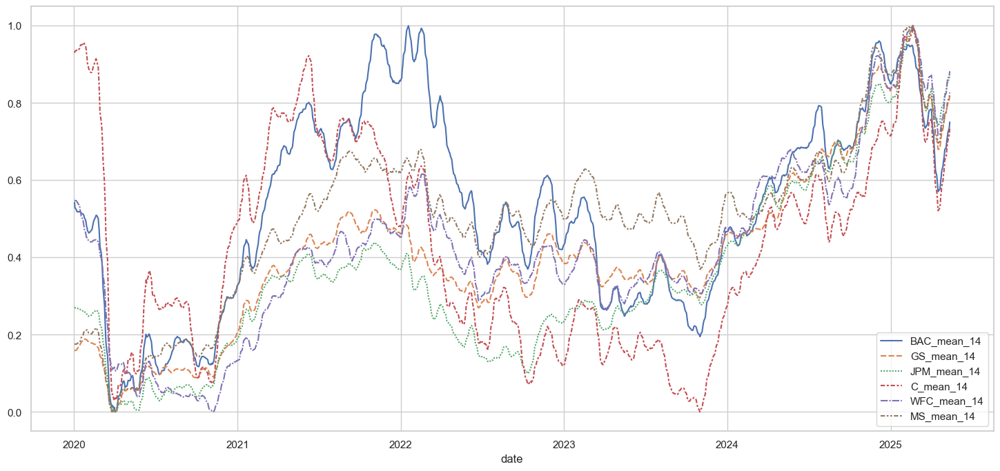

In [65]:
def plots_time_series_tech_indicators_seaborn(symbols, column, str_date_from=None, str_date_to=None):
    dt_from = None
    dt_to = None

    if str_date_from is not None:
        dt_from = datetime.strptime(str_date_from, '%Y-%m-%d').date()
    if str_date_to is not None:
        dt_to = datetime.strptime(str_date_to, '%Y-%m-%d').date()

    symbols = [symbol.upper() for symbol in symbols]
    frames = [retrieve_tech_indicator_data(symbol, str_date_from, str_date_to) for symbol in symbols]
    frames = [frame for frame in frames if frame is not None]
    dfrm = reduce(lambda x, y: pd.merge(x, y, on = 'date'), frames)
    # dfrm.dropna(inplace=True)
    columns_keep = [symbol+'_'+column for symbol in symbols]
    dfrm_subset = dfrm[dfrm.columns.intersection(columns_keep)]
    dfrm_subset = dfrm_subset.loc[dt_from:dt_to,:]

    x = dfrm_subset.values 
    min_max_scaler = preprocessing.MinMaxScaler()
    x_scaled = min_max_scaler.fit_transform(x)
    df_scaled = pd.DataFrame(x_scaled, index= dfrm_subset.index, columns=dfrm_subset.columns)
    plt.figure(figsize=(18,8))
    sns.lineplot(dashes=True, data=df_scaled)

symbols = ("BAC", "GS", "JPM", "C", "WFC", "MS")
#symbols = ("VRT", "NVDA", "MRVL", "SMCI", "SHAK")
# symbols = ("FSLR", "VRT", "COIN", "MRVL", "CRWD", "AVGO", "DDOG", "SMCI", "GOOGL", "AMZN", "SHAK", "APO", "DJT", "FCX")
# symbols = ("META", "CRWD", "LLY")
# symbols = ["PFE", "MRK", "JNJ", "REGN", "NVO", "AAPL"]

plots_time_series_tech_indicators_seaborn(symbols, 'mean_14')

In [42]:
def plots_time_series_tech_indicators_plotly(symbols, column, str_date_from=None, str_date_to=None):
    dt_from = None
    dt_to = None

    if str_date_from is not None:
        dt_from = datetime.strptime(str_date_from, '%Y-%m-%d').date()
    if str_date_to is not None:
        dt_to = datetime.strptime(str_date_to, '%Y-%m-%d').date()

    symbols = [symbol.upper() for symbol in symbols]
    frames = [retrieve_tech_indicator_data(symbol, str_date_from, str_date_to) for symbol in symbols]
    frames = [frame for frame in frames if frame is not None]
    dfrm = reduce(lambda x, y: pd.merge(x, y, on = 'date'), frames)
    # dfrm.dropna(inplace=True)
    columns_keep = [symbol+'_'+column for symbol in symbols]
    dfrm_subset = dfrm[dfrm.columns.intersection(columns_keep)]
    dfrm_subset = dfrm_subset.loc[dt_from:dt_to,:]

    x = dfrm_subset.values
    min_max_scaler = preprocessing.MinMaxScaler()
    try:
        x_scaled = min_max_scaler.fit_transform(x)
    except ValueError as e:
        print("ValueError while retrieving features (columns). Ensure that feature name is correct")

    df_scaled = pd.DataFrame(x_scaled, index= dfrm_subset.index, columns=dfrm_subset.columns)
    fig = px.line(df_scaled, x=dfrm_subset.index, y=dfrm_subset.columns)
    # fig = px.line(dfrm, x=dfrm.index, y=['close', 'ema_14', 'ema_30'])
    fig.update_xaxes(
        rangeslider_visible=True,
        rangeselector=dict(
            buttons=list([
                dict(count=1, label="1m", step="month", stepmode="backward"),
                dict(count=6, label="6m", step="month", stepmode="backward"),
                dict(count=1, label="YTD", step="year", stepmode="todate"),
                dict(count=1, label="1y", step="year", stepmode="backward"),
                dict(step="all")
            ])
        )
    )

    fig.update_layout(
    plot_bgcolor='white',
    paper_bgcolor='black'
    )
    fig.show()

    
symbols = ["BAC", "GS", "JPM", "C", "WFC", "MS"]
# symbols = ["VRT", "NVDA", "MRVL", "SMCI", "SHAK"]
# symbols = ["FSLR", "VRT", "COIN", "MRVL", "CRWD", "AVGO", "DDOG", "SMCI", "GOOGL", "AMZN", "SHAK", "APO", "DJT", "FCX"]
# symbols = ["META", "CRWD", "LLY")
# symbols = ["DDOG", "APO", "COIN", "FSLR"]
#symbols =  ["PFE", "MRK", "JNJ", "REGN", "LLY", "NVO"]

#plots_time_series_tech_indicators_plotly(symbols, 'mean_30', '2020-01-01', '2025-04-30')

In [43]:
def plotsTimeSeriesTechIndicatorsPlotly(symbols, column, dtStart, dtEnd=None):
    symbols = [symbol.upper() for symbol in symbols]
    frames = [retrieve_tech_indicator_data(symbol) for symbol in symbols]
    frames = [frame for frame in frames if frame is not None]
    dfrm = reduce(lambda x, y: pd.merge(x, y, on='date'), frames)
    dfrm.dropna(inplace=True)
    columns_keep = [symbol + '_' + column for symbol in symbols]
    dfrm_subset = dfrm[dfrm.columns.intersection(columns_keep)]
    if dtEnd is not None:
        dfrm_subset = dfrm_subset.loc[dtStart:dtEnd, :]
    else:
        dfrm_subset = dfrm_subset.loc[dtStart:, :]

    x = dfrm_subset.values
    min_max_scaler = preprocessing.MinMaxScaler()
    x_scaled = min_max_scaler.fit_transform(x)

    dfScaled = pd.DataFrame(x_scaled, index=dfrm_subset.index, columns=dfrm_subset.columns)
    fig = px.line(dfScaled, x=dfrm_subset.index, y=dfrm_subset.columns)
    # fig = px.line(dfrm, x=dfrm.index, y=['close', 'ema_14', 'ema_30'])
    fig.update_xaxes(
        rangeslider_visible=True,
        rangeselector=dict(
            buttons=list([
                dict(count=1, label="1m", step="month", stepmode="backward"),
                dict(count=6, label="6m", step="month", stepmode="backward"),
                dict(count=1, label="YTD", step="year", stepmode="todate"),
                dict(count=1, label="1y", step="year", stepmode="backward"),
                dict(step="all")
            ])
        )
    )
    fig.update_layout(
    plot_bgcolor='white',
    paper_bgcolor='black'
    )
    fig.show()

symbols = ("BAC", "GS", "JPM", "C", "WFC", "MS")
#plotsTimeSeriesTechIndicatorsPlotly(symbols, 'mean_14', '2025-04-01')

In [44]:
# # TODO: Combine this function with that of lineplot. Pass a 'type' parameter and let that control the type of plot.
def plots_box_tech_indicators_seaborn(symbols, column, str_date_from=None, str_date_to=None):
    dt_from = None
    dt_to = None

    if str_date_from is not None:
        dt_from = datetime.strptime(str_date_from, '%Y-%m-%d').date()
    if str_date_to is not None:
        dt_to = datetime.strptime(str_date_to, '%Y-%m-%d').date()

    symbols = [symbol.upper() for symbol in symbols]
    frames = [retrieve_tech_indicator_data(symbol, str_date_from, str_date_to) for symbol in symbols]
    frames = [frame for frame in frames if frame is not None]
    dfrm = reduce(lambda x, y: pd.merge(x, y, on = 'date'), frames)
    # dfrm.dropna(inplace=True)
    columns_keep = [symbol+'_'+column for symbol in symbols]
    dfrm_subset = dfrm[dfrm.columns.intersection(columns_keep)]
    dfrm_subset = dfrm_subset.loc[dt_from:dt_to,:]


    x = dfrm_subset.values
    min_max_scaler = preprocessing.MinMaxScaler()
    x_scaled = min_max_scaler.fit_transform(x)
    df_scaled = pd.DataFrame(x_scaled, index= dfrm_subset.index, columns=dfrm_subset.columns)#plt.figure(figsize=(38,18))
    #palette = sns.diverging_palette(250, 15, s=75, l=40, n=6)
    # sns.catplot(data=df_scaled, palette=palette, kind="boxen")
    sns.catplot(data=df_scaled, kind="boxen")
    #g = sns.catplot(data=df_scaled, kind="violin", inner=None, split=True, palette="pastel")
    #sns.swarmplot(data=df_scaled, size=3, ax=g.ax)

#symbols =  ["PFE", "MRK", "JNJ", "REGN", "LLY", "NVO"]
#symbols = ["FSLR", "VRT", "COIN", "MRVL", "CRWD", "AVGO", "DDOG", "SMCI"]
#lg_banks = ("BAC", "GS", "JPM", "C", "WFC", "MS")

#plots_box_tech_indicators_seaborn(symbols, "oscillator_14", '2024-04-01', '2024-04-30')

In [29]:
# Technical Indicators data is retrieved from CSV (and not SQL) pre-generated for tech indicators. 
strDateStart = '2024-01-01'

dtStart = datetime.strptime(strDateStart, '%Y-%m-%d')
#plotsTimeSeriesTechIndicatorsSeaborn(lg_banks, 'mean_14', dtStart)
# plotsTimeSeriesTechIndicatorsPlotly(lg_banks, 'mean_14', dtStart)
# plotsBoxTechIndicatorsSeaborn(lg_banks, 'mean_14', dtStart)

## Use-cases and Scenarios

Now that we have data and basic plots available, let us extend the analysis to specific use-cases. We will touch upon several scenarios such as:
- Comparison of returns of Top Tier Banks with daily closing values
- Comparison of returns of Top Tier Banks with technical indicators
- Comparison of returns of Top Tier Banks with those in the next tier
- Comparison in performance of Large Banks during COVID-19 versus the 2008-09 crisis

Note that some of the plots may be commented out to keep size manageable for guthub viewing

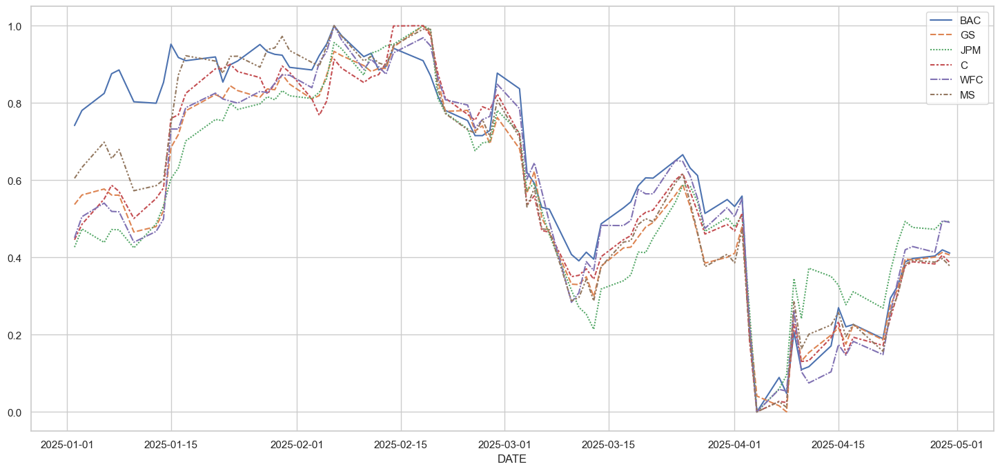

In [30]:
# May comment out some plots to keep size manageable for git-hub viewing
lg_banks = ("BAC", "GS", "JPM", "C", "WFC", "MS")
plots_time_series_closing_prices_seaborn(lg_banks, '2025-01-01', '2025-04-30')
plots_time_series_closing_prices_plotly(lg_banks, '2025-01-01', '2025-04-30')

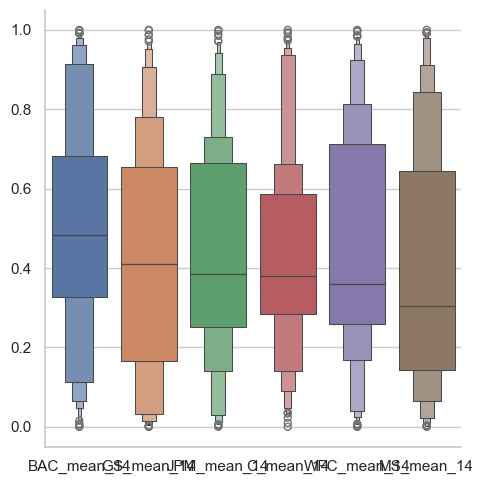

In [47]:
# Technical Indicators data is retrieved from CSV (and not SQL) pre-generated for tech indicators.
# Using Simple Moving Avg of 14 day mean as a sample, but several other indicators such as std dev, percentile closing / volume,
# stochastic oscillator, accumulation distribution, Bollinger bands can be used as well
strDateStart = '2024-01-01'
dt_start = datetime.strptime(strDateStart, '%Y-%m-%d')
plots_box_tech_indicators_seaborn(lg_banks, 'mean_14', strDateStart)
# plotsTimeSeriesTechIndicatorsPlotly(lg_banks, 'mean_14', dtStart)
# plotsBoxTechIndicatorsSeaborn(lg_banks, 'mean_14', dtStart)

### Comparison of returns of Large Banks with those from the next tier of banks
First, let us compare the results of large banks with that of next tier banks. We know that JPM, BAC, C, WFC are the largest banks in US by assets. GS and MS have a different portfolio but their asset base still puts them in the large bank category. In the next tier, by asset, we have "USB", "TFC", "PNC", "BK", "STT", "AMTD". We will plot the returns of the two set and compare the results. 

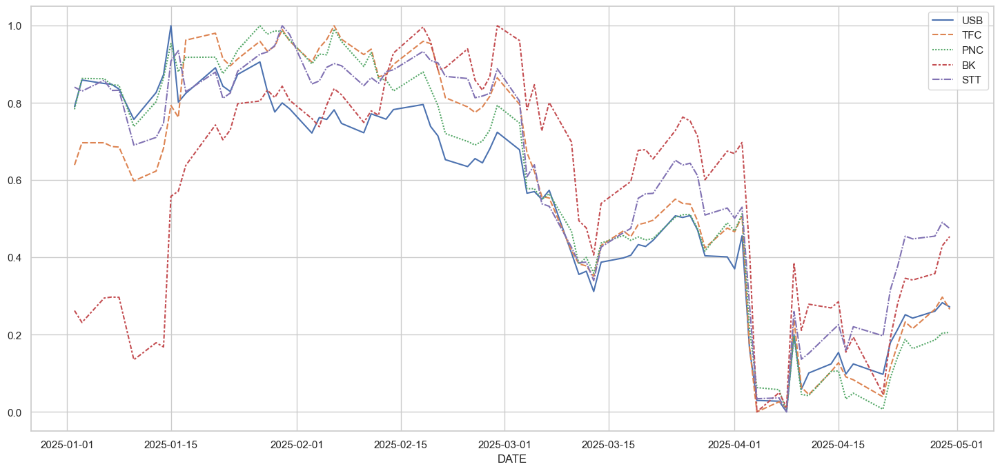

In [33]:
tier2_banks = ["USB", "TFC", "PNC", "BK", "STT"]
#plotsTimeSeriesClosingPricesPlotly(completeDataSet, lg_banks)
#plotsTimeSeriesClosingPricesPlotly(completeDataSet, tier2_banks)
plots_time_series_closing_prices_seaborn(tier2_banks, '2025-01-01', '2025-04-30')
plots_time_series_closing_prices_plotly(tier2_banks, '2025-01-01', '2025-04-30')


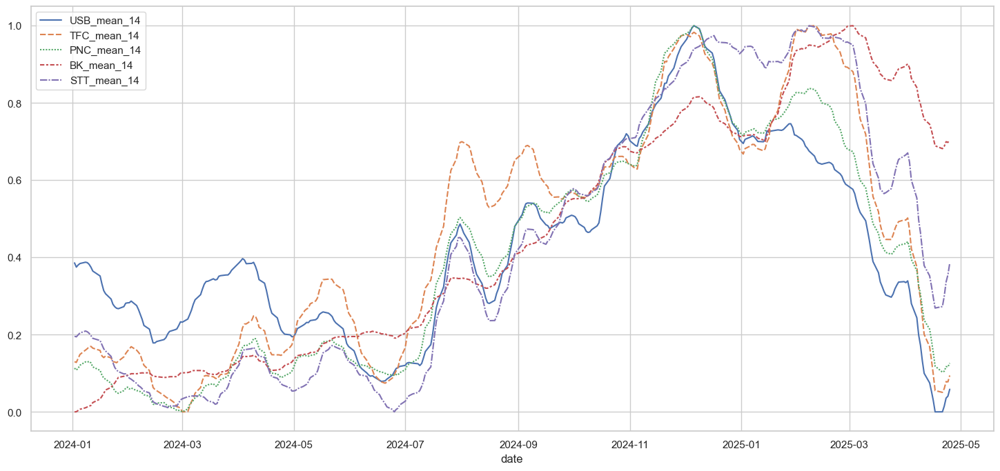

In [38]:
plots_time_series_tech_indicators_seaborn(tier2_banks, 'mean_14', strDateStart)

The primary outcomes from large banks analysis: 
- Diversification from commercial banking helped GS and MS stablize their earnings faster during COVID-19. While commercial banks had to set aside billions for potential loan defaults, the traditional investment banks had earnings support because of higher trading and investment revenuw. That is reflected in how GS and MS moved away in July-August 2020 from other commercial banks. 
- WFC has had a difficult half a decade. As deposits swelled in almost every bank, WFC had to keep its asset under the Federal mandated limit because of earlier problems. That limited its revenue beyond all other negative factors and it clearly came out as laggard compared to other large banks. 
- The banks are clearly a value stock here. The return to peak is no where close to what the FANG+MSFT growth stock have enjoyed during and after the COVID-19 peak. The peaks for large banks may not come for another year or two until the market stabilizes fully and a broad rally ensues. 
- The mid-tier or large regional banks fared no different than their larger competitors. 


### Comparison of Large Banks moving averages between 2008-09 crisis and COVID-19 pandemic
Next, we compare the impact on bank's returns in 2008-09 crisis and differntiate the duration and severity of that crisis from that of ongoing COVID-19 pandemic. For 2008-09 crisis we are using data from srart of FY2007 through end of FY2009. For COVID-19, the range is from start of FY2020 through time of this publication.  

In [53]:
strDateStartFinCrisis = '2007-01-01'
strEndDateStartFinCrisis = '2009-12-01'
dtStartFinCrisis = datetime.strptime(strDateStartFinCrisis, '%Y-%m-%d')
dtEndFinCrisis = datetime.strptime(strEndDateStartFinCrisis, '%Y-%m-%d')
# plotsTimeSeriesTechIndicatorsSeaborn(lg_banks, 'mean_14', dtStart)
plots_time_series_tech_indicators_plotly(lg_banks, 'mean_14', strDateStartFinCrisis)
# plotsBoxTechIndicatorsSeaborn(lg_banks, 'mean_14', dtStart)
strDateStartCovidCrisis = '2020-01-01'
dtStartCovidCrisis = datetime.strptime(strDateStartCovidCrisis, '%Y-%m-%d')
plots_time_series_tech_indicators_plotly(lg_banks, 'mean_14', strDateStartCovidCrisis)


Some noticeable outcomes from comparison between 2008-09 crisis and COVID-19 pandemic:

- Banks were arguably front and center of the 2008-09 crisis, but the COVID-19 crisis cannot be attributed to any industry or sector let alone financial sector. In the aftermath of the 2009-09 crisis, it took around 3 quarters for at-least some of the banks to come back to within 60% of their pre-crisis levels. In COVID-19, not at the epicenter as the cause of the crisis, some banks were able to get back to that level within a single quarter. 
- In both cases, there were clear winners and laggards. JPM came out with its reputation enhanced after 2008-09 crisis. However, in the aftermath of COVID-19 even with reasonable 1H2020 results, JPM has not yet been able to replicate that level of market returns. While GS and MS are almost at their pre-COVID19 levels, it is JPM, BAC, and C that will give investors better returns over the next several quarters relative to their current positioning. This latter set of commercial banks has more distance to cover relative to their pre-COVID 19 levels. They remain flushed with liquidity and as long as the crisis doesnt significantly deepen, these banks should reward the long term investors. 

### TODO:
- Post analysis of 2Q2020.
- Point out the long running low avg for Citi
- DONE: Add comparison with next tier of large banks: USB, TFC, PNC, BK, STT, AMTD
- Add minutely data for the day of release for each of the large banks
- Add daily data for the earnings week to check the immediate impact of earnings and difference from analysts' calls

Reach out at **psharma3@gmail.com** for any questions or inputs.